**Table of contents**<a id='toc0_'></a>    
- [Imports](#toc1_)    
- [Loading the model](#toc2_)    
- [Saliency Maps [15 marks]](#toc3_)    
  - [Constructing the dataset](#toc3_1_)    
  - [Visualizing model outputs](#toc3_2_)    
  - [Function to calculate saliency maps](#toc3_3_)    
  - [Visualizing saliency maps for the subset](#toc3_4_)    
  - [Masking image using saliency maps](#toc3_5_)    
    - [with zero](#toc3_5_1_)    
    - [with gaussian noise](#toc3_5_2_)    
  - [Does the model misclassify these images? why or why not?](#toc3_6_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[Imports](#toc0_)

In [1]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch.nn as nn
import torch
import torchvision
import einops
import random
import wandb

from torch import Tensor
from matplotlib import cm
from icecream import ic
from typing import Union, List, Tuple, Literal
from tqdm.auto import tqdm, trange
from IPython.display import display, Markdown
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, TensorDataset, Dataset
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
from skimage.feature import hog
from skimage import exposure


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "mps" if torch.backends.mps.is_available() else "cpu")
print(f"using {device.type}")


using mps


# <a id='toc2_'></a>[Loading the model](#toc0_)

In [3]:
TRAIN_DATA_PATH = 'data/network visualization'
MODEL_WEIGHTS = 'network_visualization.pth'
MEAN = np.array([0.485, 0.456, 0.406])
STD = np.array([0.229, 0.224, 0.225])
CLASSES = [
    "arctic fox", "corgi", "electric ray", "goldfish", "hammerhead shark", "horse", "hummingbird", "indigo finch", "puma", "red panda"
]


In [ ]:
model = torchvision.models.resnet18()
model.fc = nn.Linear(in_features=512, out_features=10, bias=True)
model.load_state_dict(torch.load("./network_visualization.pth", map_location=device))
model.to(device)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

# <a id='toc3_'></a>[Saliency Maps [15 marks]](#toc0_)

## <a id='toc3_1_'></a>[Constructing the dataset](#toc0_)

In [5]:
img_indices = [random.randint(1, 5) for _ in range(len(CLASSES))]
img_paths = [f"./data/network visualization/{CLASSES[idx]}/{CLASSES[idx]}_{img_num}.JPEG" for idx, img_num in enumerate(img_indices)]


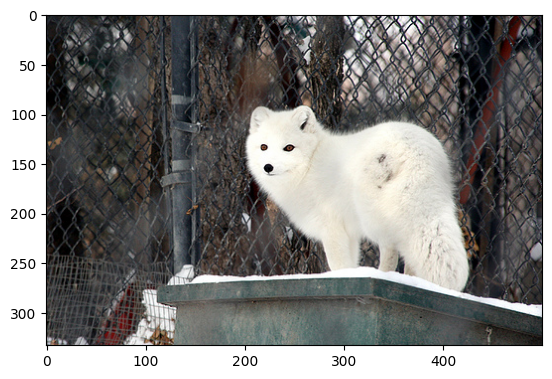

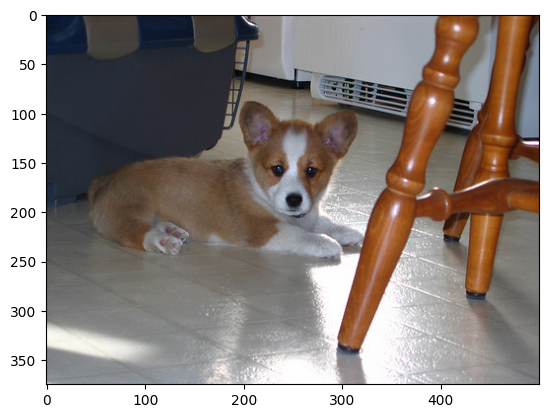

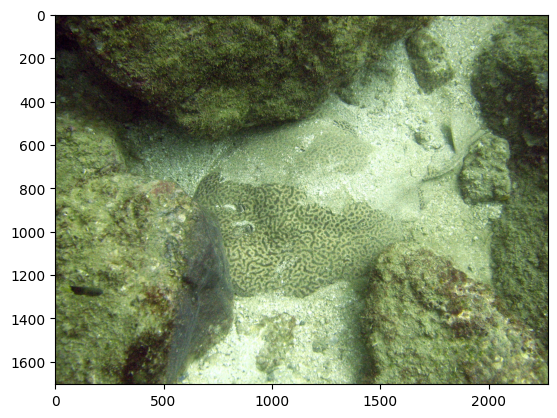

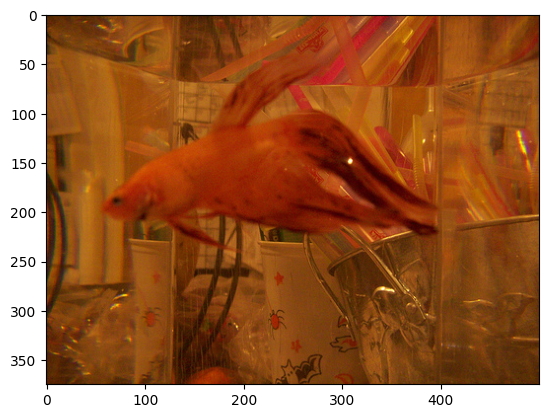

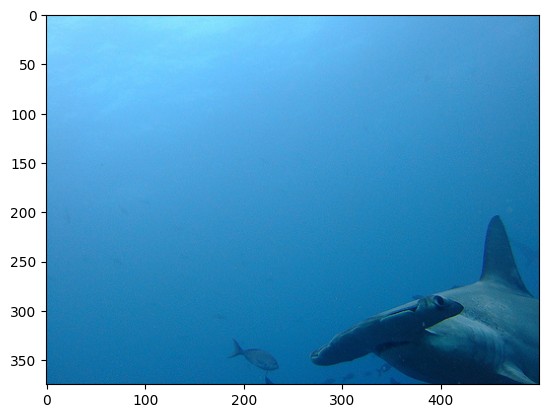

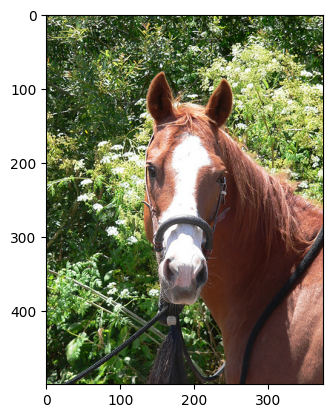

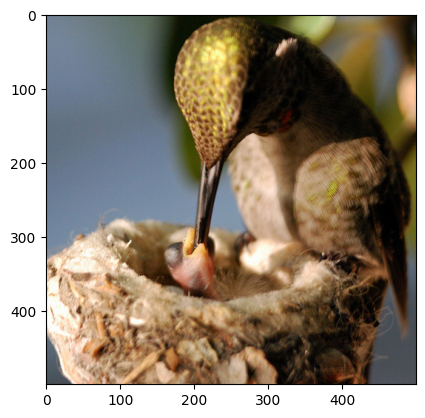

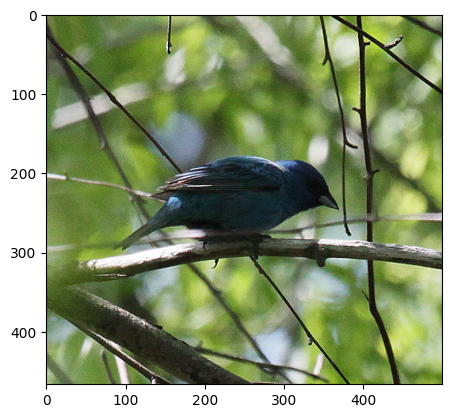

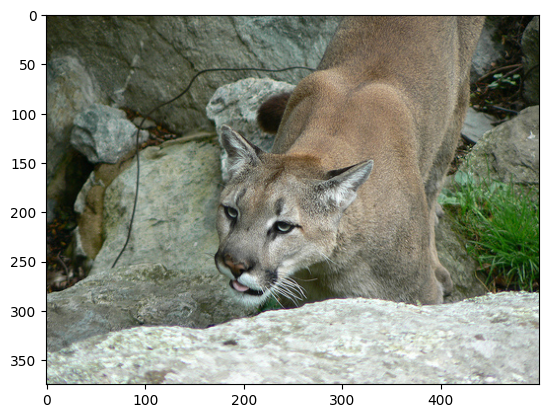

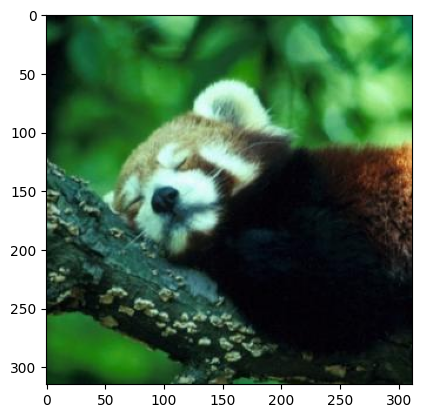

In [6]:
def visualize_raw_images(img_paths: list):
    for img_path in img_paths:
        plt.imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
        plt.show()

visualize_raw_images(img_paths)


In [7]:
class CuteDataset(Dataset):
    def __init__(self, img_paths: list, labels: list, transform=None):
        super().__init__()
        self.data = [cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB) for img_path in img_paths]
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        sample = self.data[idx]
        label = self.labels[idx]
        if self.transform:
            sample = self.transform(sample)
        return sample, label


In [8]:
def preprocess_data(img_paths: list, labels: list, mean: list=MEAN, std: list=STD):
    transformations = torchvision.transforms.Compose([
        torchvision.transforms.ToPILImage(),
        torchvision.transforms.Resize((224, 224)),
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize(mean=mean, std=std),
    ])
    dataset = CuteDataset(img_paths, labels, transformations)
    return dataset


In [9]:
cute_dataset = preprocess_data(img_paths, [i for i in range(len(CLASSES))], MEAN, STD)


In [ ]:
len(cute_dataset)


10

## <a id='toc3_2_'></a>[Visualizing model outputs](#toc0_)

In [11]:
def visualize_model_outputs(dataset: Dataset, model: nn.Module) -> None:
    nsamples = len(dataset)
    nrows = nsamples // 2
    if nsamples % 2:
        nrows += 1
    fig, axs = plt.subplots(nrows, 2, figsize=(10, 20))
    axs = axs.flatten()

    dataloader = DataLoader(cute_dataset, batch_size=1, shuffle=False)
    model.eval()
    with torch.no_grad():
        for idx, (img, label) in enumerate(dataloader):
            img = img.to(device)
            preds = model(img)
            predicted_class = nn.Softmax(1)(preds).argmax()

            axs[idx].imshow(cv2.cvtColor(cv2.imread(img_paths[idx]), cv2.COLOR_BGR2RGB))
            axs[idx].set_title(f"GT: {CLASSES[label]}, Predicted: {CLASSES[predicted_class]}")


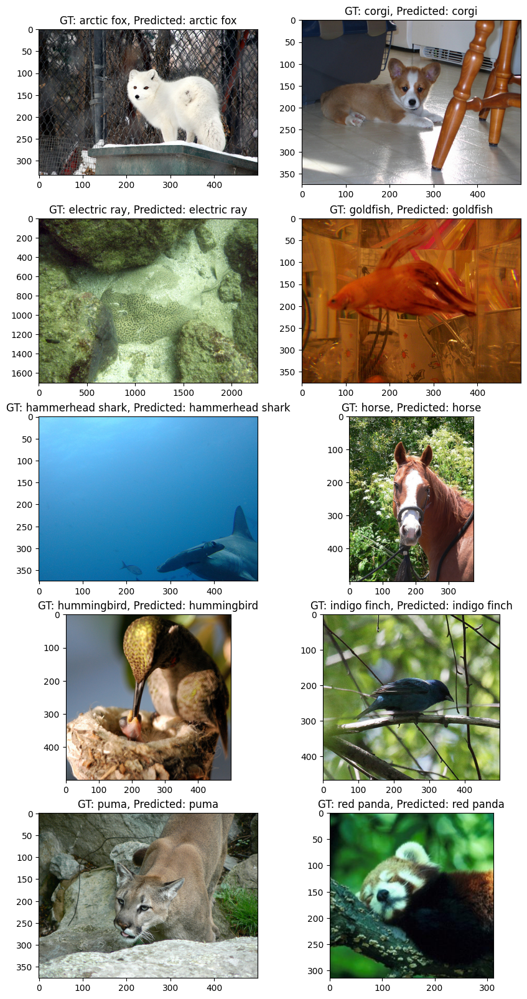

In [ ]:
visualize_model_outputs(cute_dataset, model)


## <a id='toc3_3_'></a>[Function to calculate saliency maps](#toc0_)

In [ ]:
def saliency_map(img: Tensor, label: int, model: nn.Module):
    model.eval()
    img = img.to(device)
    img = einops.rearrange(img, 'h c w -> 1 h c w')
    img.requires_grad_(True)
    criterion = nn.CrossEntropyLoss()
    logits = model(img)
    model.zero_grad()
    loss = criterion(logits, torch.tensor([label]).to(device))
    loss.backward()
    saliency = img.grad.abs()
    saliency = einops.rearrange(saliency, '1 c h w -> h w c')
    return saliency


## <a id='toc3_4_'></a>[Visualizing saliency maps for the subset](#toc0_)

In [14]:
def visualize_saliency_maps(model, dataset):
    nsamples = len(dataset)
    
    fig, axs = plt.subplots(nsamples, 2, figsize=(10, 20))
    axs = axs.flatten()

    dataloader = DataLoader(dataset, batch_size=1, shuffle=False)
    idx = 0
    saliency_maps = []

    for (img, label) in dataloader:
        img = einops.rearrange(img, '1 c h w -> c h w') # saliency map function doesnt expect batch size

        saliency = saliency_map(img, label, model)
        saliency_maps.append(saliency)
        saliency = (saliency - saliency.min()) / (saliency.max() - saliency.min()) * 255
        saliency = saliency.cpu().numpy().astype(np.uint8)
        saliency = cv2.applyColorMap(saliency, cv2.COLORMAP_INFERNO)

        img = einops.rearrange(img, 'c h w -> h w c')
        img = (img - img.min()) / (img.max() - img.min()) * 255
        img = img.cpu().numpy().astype(np.uint8)

        axs[idx].imshow(img)
        axs[idx].set_title(f"GT: {CLASSES[label.item()]}")
        idx += 1
        axs[idx].imshow(saliency)
        axs[idx].set_title("Saliency Map")
        idx += 1

    plt.tight_layout()
    plt.show()

    return saliency_maps


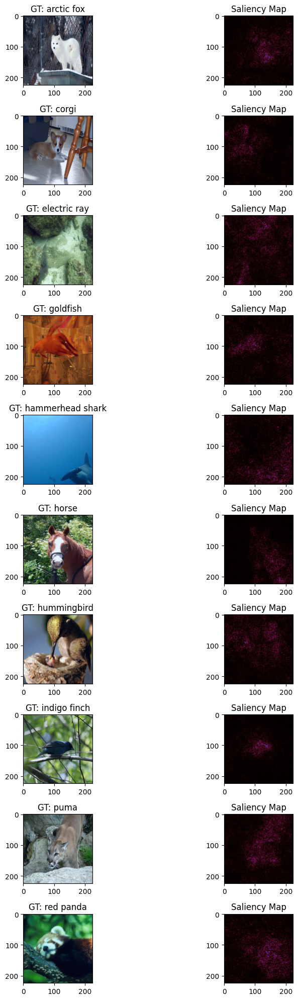

In [ ]:
saliency_maps = visualize_saliency_maps(model, cute_dataset)


## <a id='toc3_5_'></a>[Masking image using saliency maps](#toc0_)

### <a id='toc3_5_1_'></a>[with zero](#toc0_)

In [16]:
def mask_images_constant(saliency_maps: list[Tensor], dataset: Dataset):
    masked_images = []

    for idx, saliency_map in enumerate(saliency_maps):
        flattened = saliency_map.flatten().cpu().numpy()

        q3_threshold = np.percentile(flattened, 60)
        masked_img = torch.where(saliency_map >= q3_threshold, dataset[idx][0].permute(1, 2, 0).to(device), torch.zeros_like(saliency_map))
        masked_images.append(masked_img)

    return masked_images


In [17]:
def plot_masked_images(saliency_maps):
    fig, axs = plt.subplots(len(saliency_maps) // 2, 2, figsize=(20, 20))
    axs = axs.flatten()

    for idx, masked_img in enumerate(saliency_maps):
        masked_img = (masked_img - masked_img.min()) / (masked_img.max() - masked_img.min()) * 255
        masked_img = masked_img.cpu().numpy().astype(np.uint8)
        axs[idx].imshow(masked_img)
        axs[idx].set_title(f"Masked Image for {CLASSES[idx]}")

    plt.tight_layout()
    plt.show()


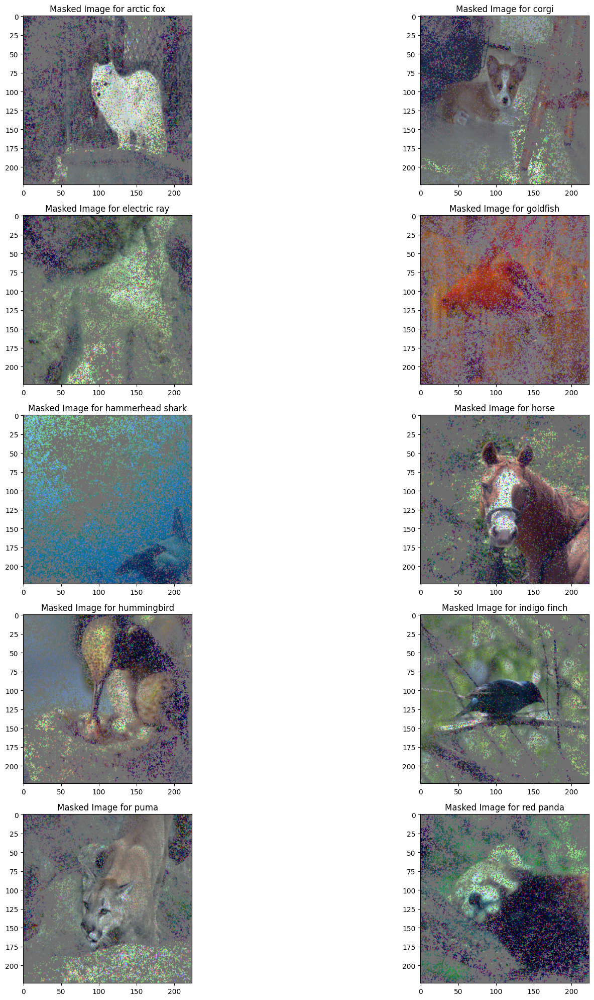

In [18]:
masked_images_const = mask_images_constant(saliency_maps, cute_dataset)

plot_masked_images(masked_images_const)


In [19]:
def predict_with_masked_imgs(model, masked_imgs):
    model.eval()
    transformations = torchvision.transforms.Compose([
        torchvision.transforms.ToPILImage(),
        torchvision.transforms.Resize((224, 224)),
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize(mean=MEAN, std=STD),
    ])

    with torch.no_grad():
        for idx, masked_img in enumerate(masked_imgs):
            masked_img = einops.rearrange(masked_img, 'h w c -> c h w')
            preds = model(transformations(masked_img).to(device).unsqueeze(0))
            predicted_class = nn.Softmax(1)(preds).argmax()
            print(f"Predicted class: {CLASSES[predicted_class]}, GT: {CLASSES[idx]}")
            masked_img = einops.rearrange(masked_img, 'c h w -> h w c')
            masked_img = (masked_img - masked_img.min()) / (masked_img.max() - masked_img.min()) * 255
            masked_img = masked_img.cpu().numpy().astype(np.uint8)
            plt.imshow(masked_img)
            plt.show()


Predicted class: hammerhead shark, GT: arctic fox


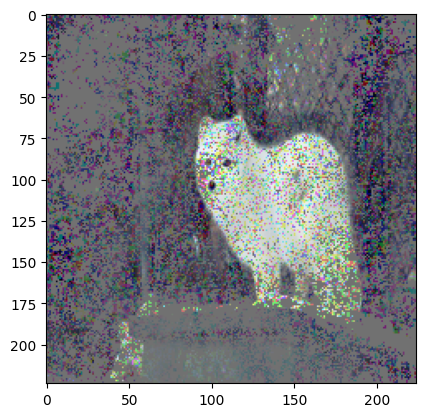

Predicted class: hammerhead shark, GT: corgi


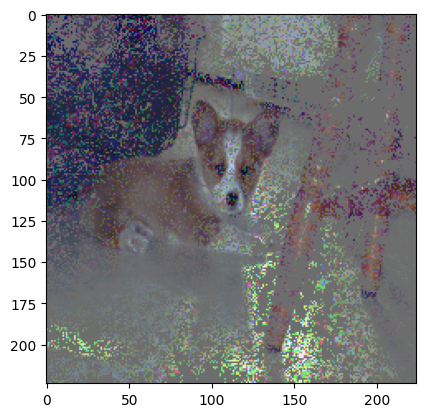

Predicted class: hammerhead shark, GT: electric ray


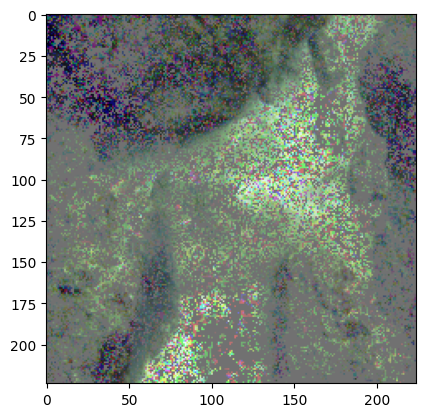

Predicted class: goldfish, GT: goldfish


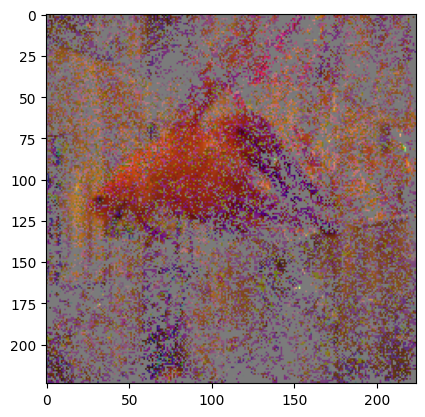

Predicted class: hammerhead shark, GT: hammerhead shark


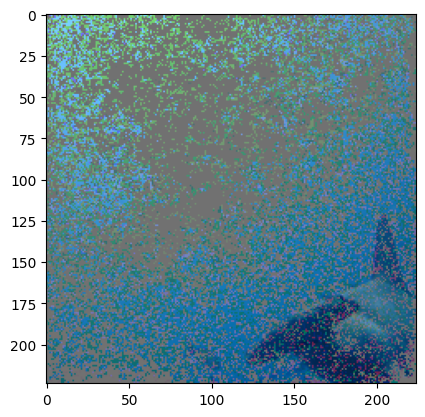

Predicted class: hammerhead shark, GT: horse


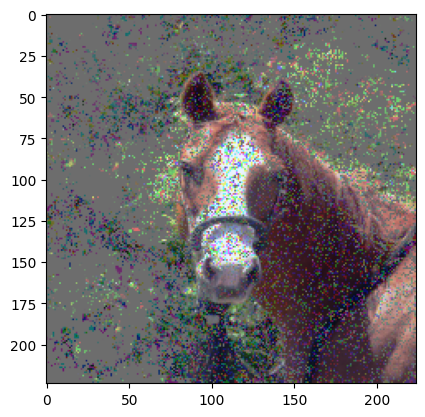

Predicted class: indigo finch, GT: hummingbird


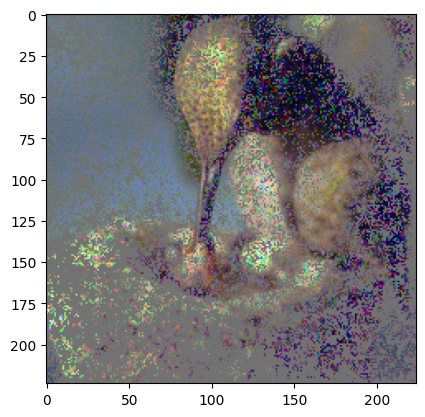

Predicted class: indigo finch, GT: indigo finch


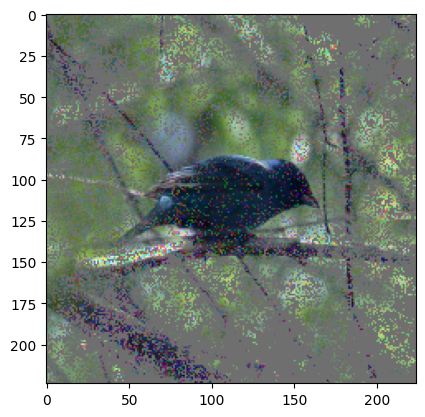

Predicted class: hammerhead shark, GT: puma


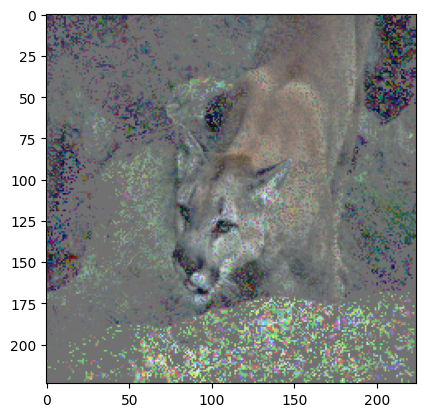

Predicted class: hammerhead shark, GT: red panda


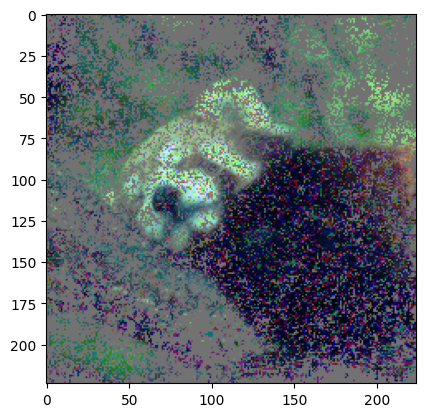

In [ ]:
predict_with_masked_imgs(model, masked_images_const)


### <a id='toc3_5_2_'></a>[with gaussian noise](#toc0_)

In [21]:
def mask_images_gaussian(saliency_maps: list[Tensor], dataset: Dataset):
    masked_images = []

    for idx, saliency_map in enumerate(saliency_maps):
        flattened = saliency_map.flatten().cpu().numpy()

        q3_threshold = np.percentile(flattened, 60)
        std = np.std(flattened)
        masked_img = torch.where(saliency_map >= q3_threshold, dataset[idx][0].permute(1, 2, 0).to(device), (torch.randn(saliency_map.shape) * 0.001 * std).to(device))
        masked_images.append(masked_img)

    return masked_images


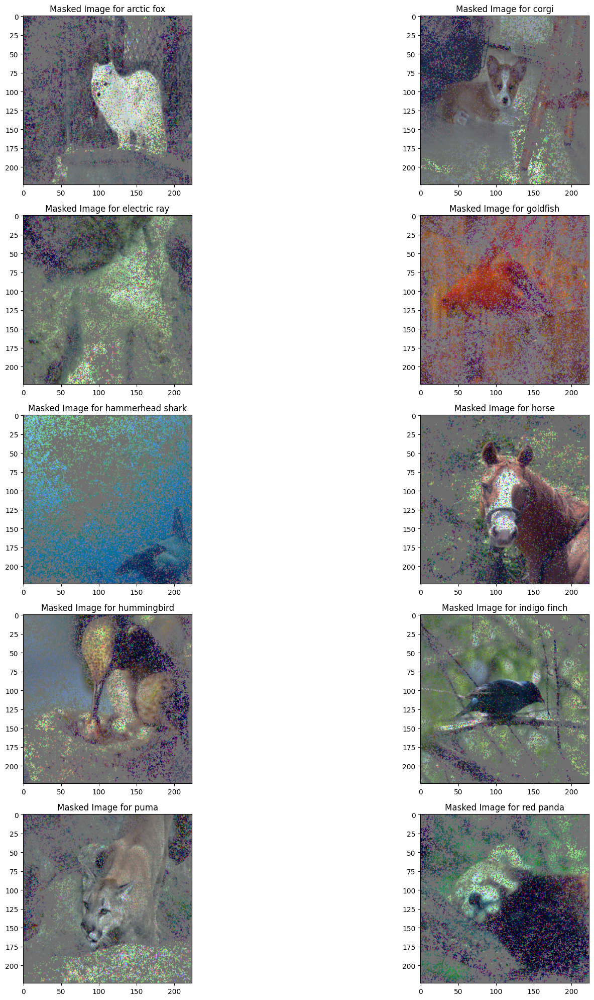

In [22]:
masked_images_gauss = mask_images_gaussian(saliency_maps, cute_dataset)
plot_masked_images(masked_images_gauss)


Predicted class: hammerhead shark, GT: arctic fox


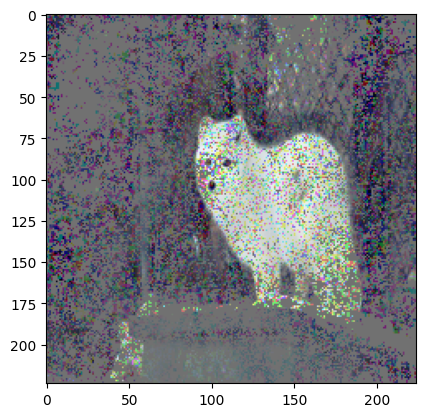

Predicted class: hammerhead shark, GT: corgi


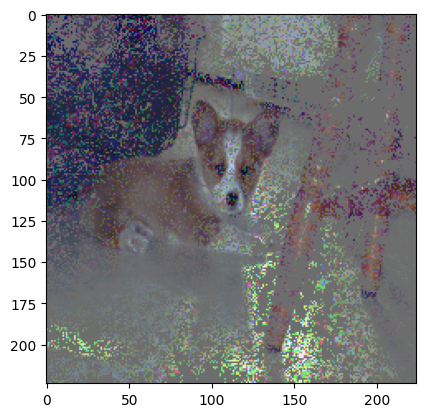

Predicted class: hammerhead shark, GT: electric ray


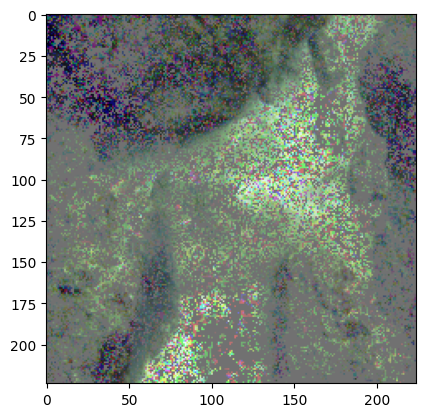

Predicted class: goldfish, GT: goldfish


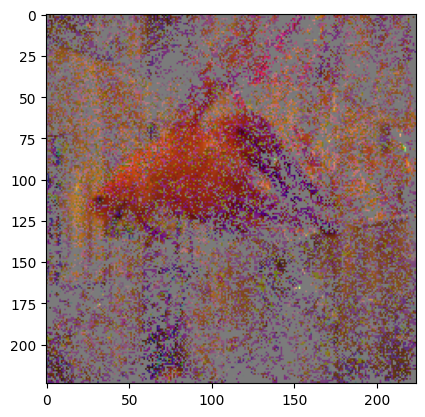

Predicted class: hammerhead shark, GT: hammerhead shark


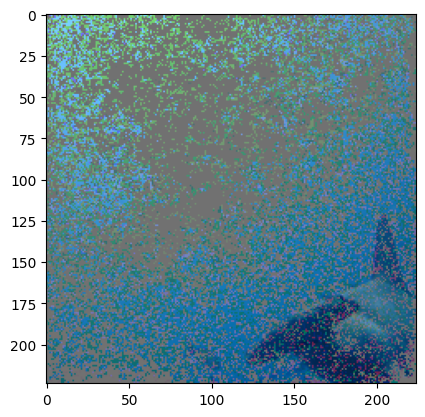

Predicted class: hammerhead shark, GT: horse


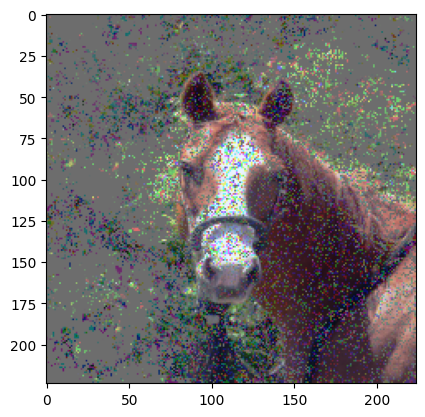

Predicted class: indigo finch, GT: hummingbird


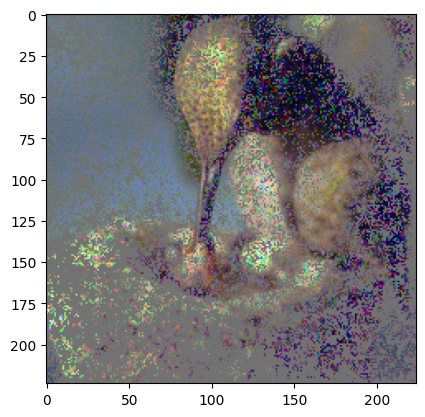

Predicted class: indigo finch, GT: indigo finch


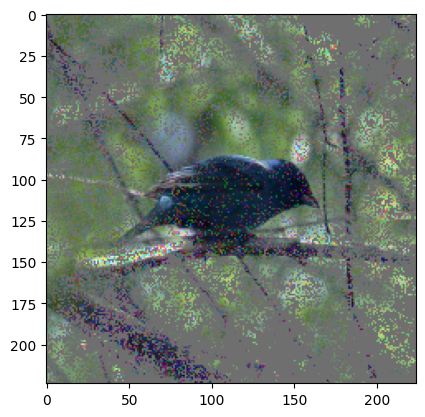

Predicted class: hammerhead shark, GT: puma


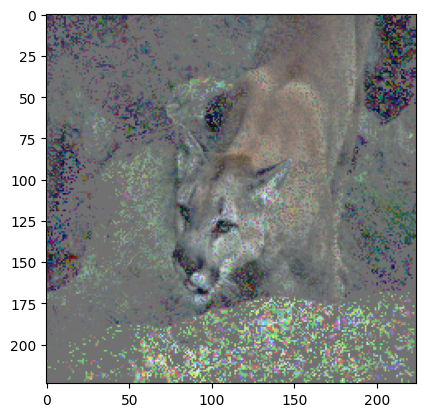

Predicted class: hammerhead shark, GT: red panda


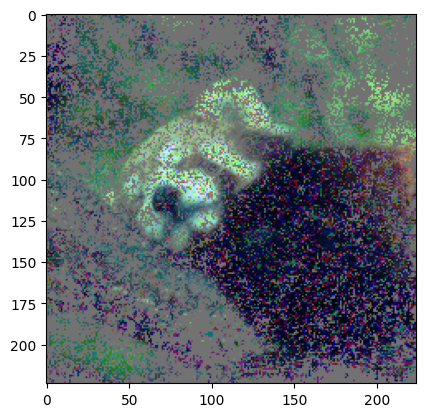

In [ ]:
predict_with_masked_imgs(model, masked_images_gauss)


## <a id='toc3_6_'></a>[Does the model misclassify these images? why or why not?](#toc0_)

It misclassifies some of them, depending on the number of pixels masked. When there are very few pixels masked, the performance is basically retained. However, when there are a lot of pixels disturbed, there are some classes that are predicted more than the others, such as hammerhead shark. This can be because for the wrongly predicted classes, the model isnt looking at the foreground as much when deciding the prediction and concludes that the darkness matches the darkness of the hammerhead shark images.